<a href="https://colab.research.google.com/github/adarsharegmi/NetCDF-task/blob/main/Question_1_i_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from dateutil.parser import parse 
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

In [ ]:
df = pd.read_csv("GW036582.2.2.csv")

In [ ]:
df


,Time,GW036582.2.2,Unnamed: 2,Unnamed: 3
0,and,110.00,NaN,NaN
1,Date,Bore level below MP,NaN,NaN
2,Date and time,Mean,Quality,Comments
3,00:00:00 01/11/2009,NaN,255,Sites:
4,00:00:00 01/12/2009,29.248,5,GW036582.2.2 - GWMA016-AMBERDELL- 680 BUNNALOO...
...,...,...,...,...
140,00:00:00 01/04/2021,28.007,145,
141,00:00:00 01/05/2021,28.307,145,
142,00:00:00 01/06/2021,28.190,145,
143,00:00:00 01/07/2021,27.830,145,


In [ ]:
import os, re
files = os.listdir() # ignore sample_data and .config
csv_files = [i for i in files  if re.search(".csv",i) is not None ]

In [ ]:
file_locations = []
for i in csv_files: 
  df2 = pd.read_csv(i)
  data = df2['Unnamed: 3'][4]
  latitude = data.split("Lat:")[1].split(" ")[0]
  longitude = data.split("Long:")[1].split(" ")[0]

  info = (i, latitude, longitude)
  file_locations.append(info)
file_locations

[('GW403747.3.3.csv', '-35.02931202', '145.59362677'),
 ('GW036597.1.2.csv', '-33.7657', '147.4806'),
 ('GW036211.1.1.csv', '-35.06580143', '145.3797645'),
 ('GW273166.1.1.csv', '-35.9753313', '146.6173406'),
 ('GW036284.2.2.csv', '-33.35378083', '145.03003542'),
 ('GW040956.3.3.csv', '-34.69664', '146.34222'),
 ('GW036871.3.3.csv', '-35.27369', '144.53366'),
 ('GW273167.2.2.csv', '-35.10069265', '147.36927431'),
 ('GW036275.2.2.csv', '-34.67366381', '145.62335066'),
 ('GW036582.2.2.csv', '-35.81162421', '144.83094756')]

In [ ]:
# okay we have latitude and longitudes with respect to csv files
# now lets check it belongs to MD area or not

In [ ]:
! pip install pyshp

     |████████████████████████████████| 219 kB 5.0 MB/s 
  Created wheel for pyshp: filename=pyshp-2.1.3-py3-none-any.whl size=37325 sha256=bee4685269b5a80e7dbc6a7854222aa77a911f17267dcd0ffc10de31cd3db394
  Stored in directory: /root/.cache/pip/wheels/43/f8/87/53c8cd41545ba20e536ea29a8fcb5431b5f477ca50d5dffbbe
Successfully built pyshp


In [ ]:
!pip install geopandas

In [ ]:
# importing required libraries
import numpy as np
from shapely.geometry import Point
from shapely.geometry.polygon import Polygon
import shapefile
from shapely.geometry import shape
import geopandas as gpd

In [ ]:
# reading the Shapefile
MDB_north =  shapefile.Reader("MDB_north.shp")
MDB_south = shapefile.Reader("MDB_south.shp")

In [ ]:
all_shapes_N = MDB_north.shapes()
all_shapes_S = MDB_south.shapes()

In [ ]:
shape(all_shapes_N)

In [ ]:
shape(all_shapes_S)

In [ ]:
def check_data_exists(data:list):
  true_files = []
  for single_file in data:
    if Point((float(single_file[1]),float(single_file[2]))).within(shape(all_shapes_N)):
      true_files.append(single_file[0])
  return true_files

In [ ]:
check_data_exists(file_locations)

[]

In [ ]:
gdf1 = gpd.read_file("MDB_north.shp")
gdf2 = gpd.read_file("MDB_south.shp")
gdf = gpd.GeoDataFrame(pd.concat([gdf1, gdf2]))

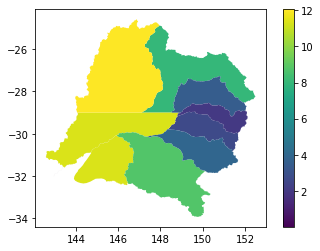

In [ ]:
gdf1["area"] = gdf1.area
gdf1.plot("area", legend=True)


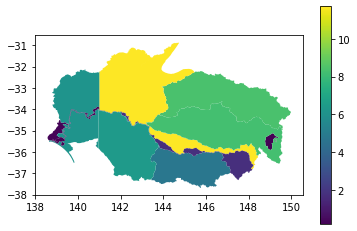

In [ ]:
gdf2["area"] = gdf2.area
gdf2.plot("area", legend=True)


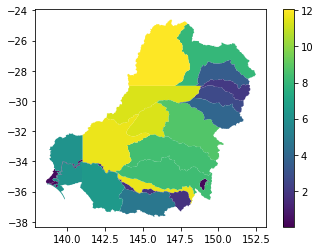

In [ ]:
gdf["area"] = gdf.area
gdf.plot("area", legend=True)

In [ ]:
gdf.head()

,geometry,area
0,"MULTIPOLYGON (((148.80173 -29.18485, 148.80119...",0.006680
1,"POLYGON ((151.96698 -28.51227, 151.96697 -28.5...",8.049912
2,"MULTIPOLYGON (((151.66687 -29.98005, 151.66687...",2.714205
3,"MULTIPOLYGON (((143.38390 -31.55762, 143.38422...",11.379670
4,"MULTIPOLYGON (((147.40799 -30.14127, 147.40821...",8.780613


In [ ]:
# plotting time series
import matplotlib.pyplot as plt

# Set-up to have matplotlib use its support for notebook inline plotsx
%matplotlib inline

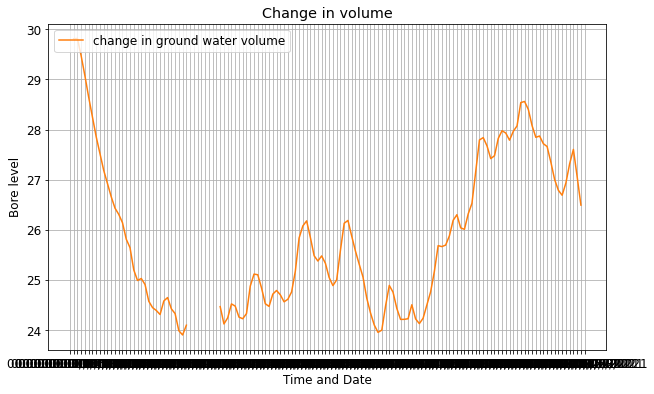

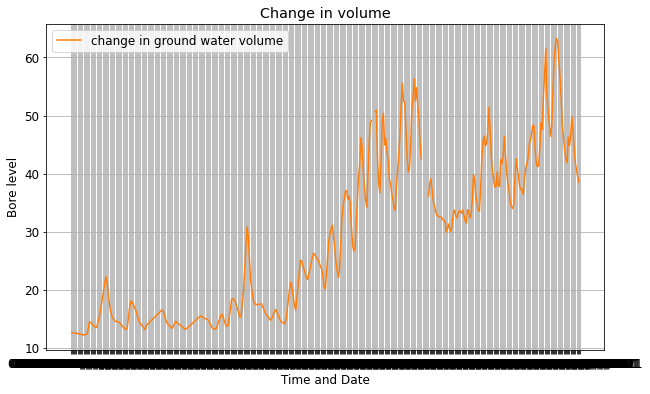

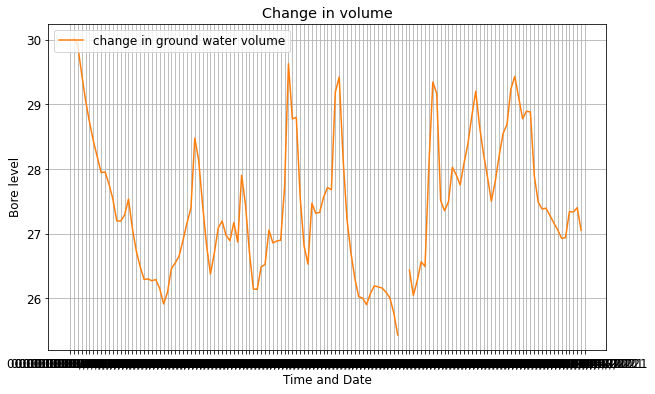

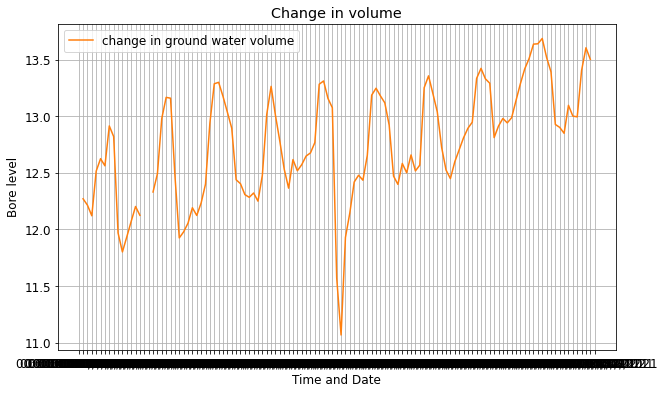

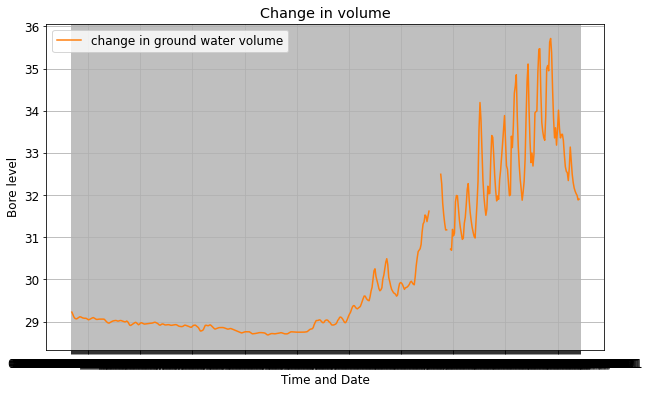

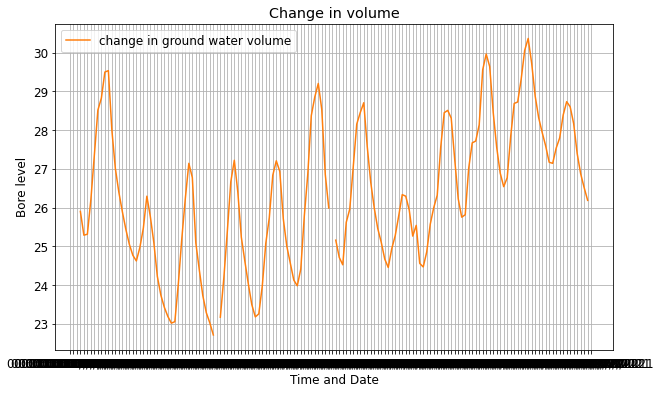

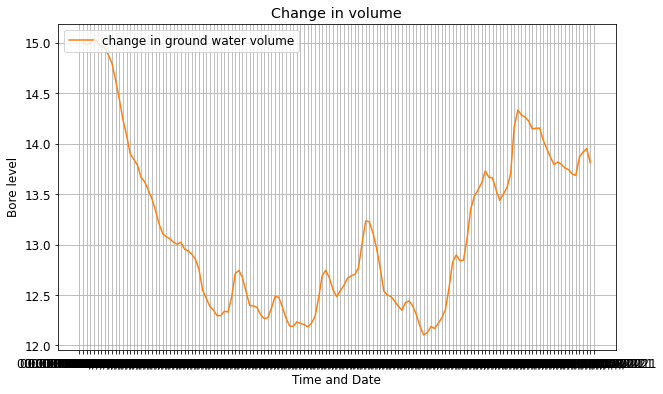

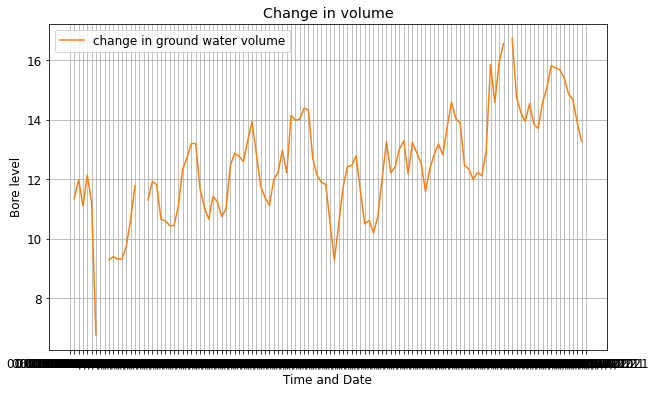

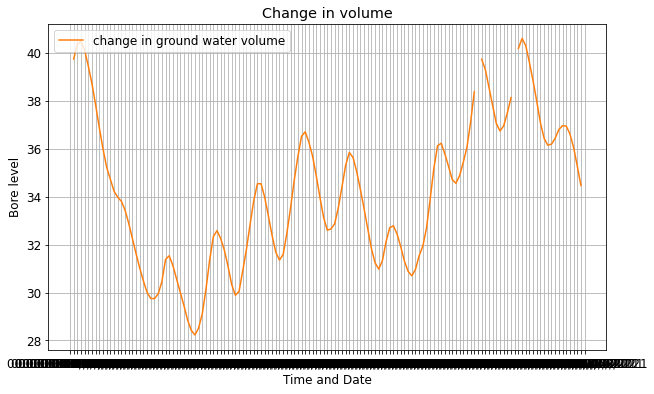

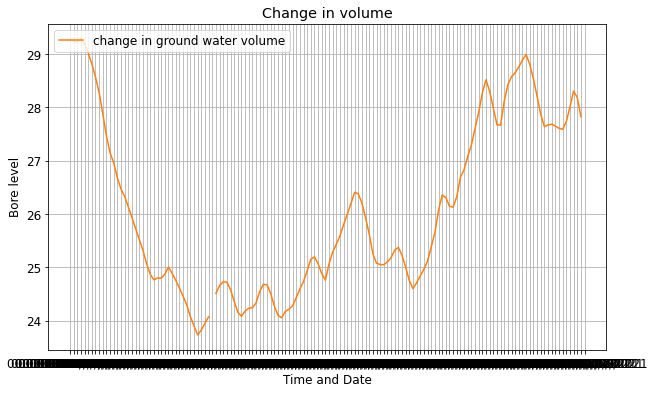

In [ ]:
for file in file_locations:
  df = pd.read_csv(file[0])
  columns = list(df.iloc[2,:].values)[:-1]
  df = df.iloc[3:, :-1,]
  df.columns=columns

  plt.rc('font', size=12)
  fig, ax = plt.subplots(figsize=(10, 6))

  # Specify how our lines should look
  ax.plot(df.iloc[:,0], df.iloc[:,1], color='tab:orange', label='change in ground water volume')

  # Same as above
  ax.set_xlabel('Time and Date')
  ax.set_ylabel('Bore level')
  ax.set_title('Change in volume')
  ax.grid(True)
  ax.legend(loc='upper left');
  plt.show()